**Importing Library** 

In [8]:
import pandas as pd
#pandas is use for importing data set in pythan
import numpy as np
#nummpy is use  large collection of high-level mathematical functions to operate 
import matplotlib.pyplot as plt
#Matplotlib is a plotting library for creating static, animated, and interactive visualizations in Python
import seaborn as sns
import plotly.express as px

importing dataset

In [4]:
Covid_india = pd.read_csv("/content/covid_19_india.csv")

In [5]:
Covid_india.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,1,2020-01-30,6:00 PM,Kerala,1,0,0,0,1
1,2,2020-01-31,6:00 PM,Kerala,1,0,0,0,1
2,3,2020-02-01,6:00 PM,Kerala,2,0,0,0,2
3,4,2020-02-02,6:00 PM,Kerala,3,0,0,0,3
4,5,2020-02-03,6:00 PM,Kerala,3,0,0,0,3


Drop the columns 

In [6]:
Covid_india = Covid_india.drop(columns=['Sno'])
Covid_india

,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,2020-01-30,6:00 PM,Kerala,1,0,0,0,1
1,2020-01-31,6:00 PM,Kerala,1,0,0,0,1
2,2020-02-01,6:00 PM,Kerala,2,0,0,0,2
3,2020-02-02,6:00 PM,Kerala,3,0,0,0,3
4,2020-02-03,6:00 PM,Kerala,3,0,0,0,3
...,...,...,...,...,...,...,...,...
18105,2021-08-11,8:00 AM,Telangana,-,-,638410,3831,650353
18106,2021-08-11,8:00 AM,Tripura,-,-,77811,773,80660
18107,2021-08-11,8:00 AM,Uttarakhand,-,-,334650,7368,342462
18108,2021-08-11,8:00 AM,Uttar Pradesh,-,-,1685492,22775,1708812


In [11]:
Covid_india.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18110 entries, 0 to 18109
Data columns (total 8 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Date                      18110 non-null  object
 1   Time                      18110 non-null  object
 2   State/UnionTerritory      18110 non-null  object
 3   ConfirmedIndianNational   18110 non-null  object
 4   ConfirmedForeignNational  18110 non-null  object
 5   Cured                     18110 non-null  int64 
 6   Deaths                    18110 non-null  int64 
 7   Confirmed                 18110 non-null  int64 
dtypes: int64(3), object(5)
memory usage: 1.1+ MB


**Check the null the value**

In [12]:
Covid_india.isnull().sum()  #is null is cheack and count the nan value in each columns

Date                        0
Time                        0
State/UnionTerritory        0
ConfirmedIndianNational     0
ConfirmedForeignNational    0
Cured                       0
Deaths                      0
Confirmed                   0
dtype: int64

**check the shape of data no. of col and no. of row**

In [13]:
Covid_india.shape

(18110, 8)

In [14]:
state = Covid_india['State/UnionTerritory'].value_counts()
state

Kerala                                      560
Delhi                                       528
Rajasthan                                   527
Uttar Pradesh                               526
Haryana                                     526
Ladakh                                      523
Tamil Nadu                                  523
Punjab                                      521
Jammu and Kashmir                           521
Maharashtra                                 520
Karnataka                                   520
Andhra Pradesh                              518
Uttarakhand                                 515
Odisha                                      514
West Bengal                                 512
Puducherry                                  512
Chhattisgarh                                511
Chandigarh                                  511
Gujarat                                     510
Madhya Pradesh                              508
Himachal Pradesh                        

Text(0, 0.5, 'no. of cases')

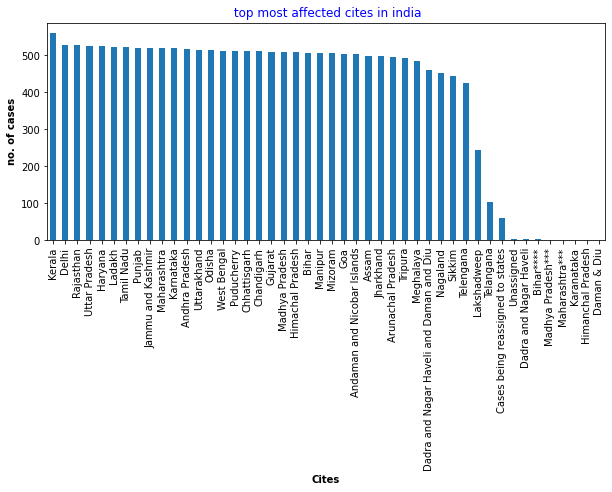

In [15]:
#top 5 cities are:in bar graph
Covid_india['State/UnionTerritory'].value_counts().plot.bar(figsize = (10,4))
plt.title(' top most affected cites in india', fontsize=12, color='blue')
plt.xlabel('Cites', fontweight='bold', color='black')
plt.ylabel('no. of cases', fontweight='bold', color='black')

In [16]:
Mortality_Rate = Covid_india[['State/UnionTerritory','Deaths','Confirmed','Cured']]
Mortality_Rate

,State/UnionTerritory,Deaths,Confirmed,Cured
0,Kerala,0,1,0
1,Kerala,0,1,0
2,Kerala,0,2,0
3,Kerala,0,3,0
4,Kerala,0,3,0
...,...,...,...,...
18105,Telangana,3831,650353,638410
18106,Tripura,773,80660,77811
18107,Uttarakhand,7368,342462,334650
18108,Uttar Pradesh,22775,1708812,1685492


In [19]:
Mortality_Rate["Mortality Rate (per 100)"]= np.round(np.nan_to_num(100*Mortality_Rate["Deaths"]/Mortality_Rate["Confirmed"]),4)
Mortality_Rate[:].style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Cured"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}",subset=["Mortality Rate (per 100)"])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [21]:
data1 = Mortality_Rate[Mortality_Rate["Mortality Rate (per 100)"] >= 5]
data1[:].style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Cured"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}",subset=["Mortality Rate (per 100)"])

,State/UnionTerritory,Deaths,Confirmed,Cured,Mortality Rate (per 100)
132,Karnataka,1,6,0,16.67
135,Delhi,1,7,1,14.29
145,Karnataka,1,6,0,16.67
149,Delhi,1,7,2,14.29
151,Karnataka,1,6,0,16.67
163,Delhi,1,7,2,14.29
165,Karnataka,1,6,0,16.67
178,Delhi,1,8,2,12.50
180,Karnataka,1,11,0,9.09
193,Delhi,1,10,2,10.00


In [32]:
Covid_india.replace(np.NaN, 0, inplace=True)
Covid_india.replace('0#', 0, inplace=True)
#covid_19_India.drop(['ConfirmedIndianNational','ConfirmedForeignNational'],axis=1, inplace = True)
Covid_india.fillna(0)
Covid_india['Confirmed'].astype(int)
Covid_india['Cured'].astype(int)
Covid_india['Deaths'].astype(int)
Covid_india['Active']= Covid_india['Confirmed']- (Covid_india['Cured'] + Covid_india['Deaths'])

In [34]:
Covid_india

,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Active
0,2020-01-30,6:00 PM,Kerala,1,0,0,0,1,1
1,2020-01-31,6:00 PM,Kerala,1,0,0,0,1,1
2,2020-02-01,6:00 PM,Kerala,2,0,0,0,2,2
3,2020-02-02,6:00 PM,Kerala,3,0,0,0,3,3
4,2020-02-03,6:00 PM,Kerala,3,0,0,0,3,3
...,...,...,...,...,...,...,...,...,...
18105,2021-08-11,8:00 AM,Telangana,-,-,638410,3831,650353,8112
18106,2021-08-11,8:00 AM,Tripura,-,-,77811,773,80660,2076
18107,2021-08-11,8:00 AM,Uttarakhand,-,-,334650,7368,342462,444
18108,2021-08-11,8:00 AM,Uttar Pradesh,-,-,1685492,22775,1708812,545


In [7]:
state_wise = Covid_india.groupby('State/UnionTerritory')['Confirmed','Cured','Deaths'].sum().reset_index()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


## Top 10 states with highest number of Confirmed cases

In [9]:
px.bar(x=state_wise.nlargest(10,"Confirmed")["State/UnionTerritory"],
       y = state_wise.nlargest(10,"Confirmed")["Confirmed"],
       color_discrete_sequence=px.colors.diverging.Picnic,
       title="Top 10 states with highest number of Confirmed cases")

## Top 10 states with highest number of Cured cases

In [10]:
px.bar(x=state_wise.nlargest(10,"Cured")["State/UnionTerritory"],
       y = state_wise.nlargest(10,"Cured")["Cured"],
       color_discrete_sequence=px.colors.sequential.Sunset,
       title="Top 10 states with highest number of Cured cases")

## Top 10 states with highest number of Deaths

In [11]:
px.bar(x=state_wise.nlargest(10,"Deaths")["State/UnionTerritory"],
       y = state_wise.nlargest(10,"Deaths")["Deaths"],
       color_discrete_sequence=px.colors.diverging.curl,
       title="Top 10 states with highest number of Deaths")